<a href="https://colab.research.google.com/github/prakashece/Windows-classification-and-bounding-box-detection-/blob/main/RCNN_Project_ML__Report.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Project Report
#Windows Classification and Detection by Fine Tuning Faster-RCNN Resnet50 Model

By Prakash Ravi, Jun Qian, Gabe Skidmore

**Abstract**

In this project we fine-tuned the fasterRCNN resnet-50 model by fetching the pre trained weights and running it against our windows dataset for classification and detection. We pretty much got our classification loss= 0.2312 and the bounding box regression loss = 0.1245 for 5 epochs. To explain our work this notebook is subdivided into following parts. 


**Table of contents**

Data preprocessing

Creating a dataset

Loading the dataset using data loader class

Importing the fasterRCNN resnet-50

Training the model with training dataset

Loading and testing the trained model

Results

Conclusion

References 

Link for files

The link to downlaod the dependencies are given at the end 


#Data Preprocessing 

In this cell we have created our own class instead of a pytorch data loader class for wrapping the images and the annotations from json file together for training the model. The annotations has bounding boxes, image_id, labels, and instance id's of the loaded image file.





In [ ]:
import os
import torch
import torchvision
from PIL import Image
from pycocotools.coco import COCO

class myOwnDataset(torch.utils.data.Dataset):
    def __init__(self, root, annotation, transforms=None):
        self.root = root
        self.transforms = transforms
        self.coco = COCO(annotation)
        self.ids = list(sorted(self.coco.imgs.keys()))

    def __getitem__(self, index):
        # Own coco file
        coco = self.coco
        # Image ID
        img_id = self.ids[index]
        #categories
        # List: get annotation id from coco
        ann_ids = coco.getAnnIds(imgIds=img_id)
        # Dictionary: target coco_annotation file for an image
        coco_annotation = coco.loadAnns(ann_ids)
        # path for input image
        path = coco.loadImgs(img_id)[0]['file_name']
        # open the input image
        img = Image.open(os.path.join(self.root, path))

        # number of objects in the image
        num_objs = len(coco_annotation)

        # Bounding boxes for objects
        # In coco format, bbox = [xmin, ymin, width, height]
        # In pytorch, the input should be [xmin, ymin, xmax, ymax]
        boxes = []
        mask=[]
        for i in range(num_objs):
            xmin = coco_annotation[i]['bbox'][0]
            ymin = coco_annotation[i]['bbox'][1]
            xmax = coco_annotation[i]['bbox'][2]
            ymax = coco_annotation[i]['bbox'][3]
            boxes.append([xmin, ymin, xmax, ymax])
            #print("before", boxes[-1])
            #print()
            mask.append([0,0,0,0])
        boxes = torch.as_tensor(boxes, dtype=torch.float32)
        #print("after",boxes)
        #print()
        mask = torch.as_tensor(mask, dtype=torch.int64)
        #labels = torch.tensor([categories])
        # Tensorise img_id
        image_id=[]
        for i in range(num_objs):
            image_id.append(coco_annotation[i]['image_id'])
        image_id = torch.as_tensor(image_id, dtype=torch.int64)  
            #img_id = torch.tensor([img_id])
        # Size of bbox (Rectangular)
        labels = []
        for i in range(num_objs):
            labels.append(coco_annotation[i]['category_id'])
        labels = torch.as_tensor(labels, dtype=torch.int64)
        #image ID
        Id=[]
        for i in range(num_objs):
            Id.append(coco_annotation[i]['id'])
        Id = torch.as_tensor(Id, dtype=torch.int64)
        # Iscrowd
        iscrowd = torch.zeros((num_objs,), dtype=torch.int64)
        #mask = torch.zeros((num_objs,), dtype=torch.int64)
        # Annotation is in dictionary format
        my_annotation = {}
        my_annotation["boxes"] = boxes
        my_annotation["labels"] = labels
        my_annotation["id"] = Id
        my_annotation["image_id"] = image_id
        my_annotation["iscrowd"] = iscrowd
        #my_annotation["masks"]= mask

        if self.transforms is not None:
            img = self.transforms(img)

        return img, my_annotation

    def __len__(self):
        return len(self.ids)

**This function helps us to mount the dirve for accessing the datasets and json files**




In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import sys
sys.path.append('/content/drive/My Drive/rcnn_dataset')

A helper function is created to convert the image and annotations to a tensor format 

In [ ]:
def get_transform():
    custom_transforms = []
    custom_transforms.append(torchvision.transforms.ToTensor())
    return torchvision.transforms.Compose(custom_transforms)

#Creating The Dataset

Directories to access the image and json files have been defined and the custom made data loader class is called to create the dataset for the algorithm.

In [ ]:
train_data_dir = '/content/drive/MyDrive/rcnn_dataset/rcnn_dataset/'
train_coco = '/content/drive/MyDrive/rcnn_dataset/window_coco_v2.json'

def collate_fn(batch):
    return tuple(zip(*batch))

# create own Dataset
my_dataset = myOwnDataset(root=train_data_dir,
                          annotation=train_coco,
                          transforms=get_transform())

loading annotations into memory...
Done (t=0.09s)
creating index...
index created!


Total number of samples, image and taget tensors from the dataset has been printed out.

In [ ]:
img, target= my_dataset[4]
len(my_dataset)
#for i in range(len(my_dataset)):
    #img, target= my_dataset[i]
    #print(img.shape)
    

2370

In [ ]:
print(img)
print(target)

tensor([[[0.0627, 0.1843, 0.2196,  ..., 0.0314, 0.0902, 0.0000],
         [0.0627, 0.6235, 0.7686,  ..., 0.1725, 0.2118, 0.1020],
         [0.0000, 0.2784, 0.2627,  ..., 0.1882, 0.2118, 0.0784],
         ...,
         [0.0000, 0.2784, 0.9569,  ..., 0.9216, 0.9176, 0.4980],
         [0.0078, 0.0745, 0.7255,  ..., 1.0000, 0.9686, 0.5255],
         [0.0275, 0.0000, 0.2784,  ..., 0.4941, 0.5137, 0.1647]],

        [[0.0627, 0.1843, 0.2196,  ..., 0.0314, 0.0902, 0.0000],
         [0.0627, 0.6235, 0.7686,  ..., 0.1725, 0.2118, 0.1020],
         [0.0000, 0.2784, 0.2627,  ..., 0.1882, 0.2118, 0.0784],
         ...,
         [0.0000, 0.2784, 0.9569,  ..., 0.9216, 0.9176, 0.4980],
         [0.0078, 0.0745, 0.7255,  ..., 1.0000, 0.9686, 0.5255],
         [0.0275, 0.0000, 0.2784,  ..., 0.4941, 0.5137, 0.1647]],

        [[0.0627, 0.1843, 0.2196,  ..., 0.0314, 0.0902, 0.0000],
         [0.0627, 0.6235, 0.7686,  ..., 0.1725, 0.2118, 0.1020],
         [0.0000, 0.2784, 0.2627,  ..., 0.1882, 0.2118, 0.

#Loading The Dataset Using Data Loader Class

pytorch provides a dataloader class, which can be called to convert our dataset into batches by shuffling and assigning the number of workers to it. The below cell calls the dataloader class to make our dataset shuffled and convert it to a batch size of 1 and assign's it to 0 workers. The collate function finally zips the images and annotations to tuple and loads it into the variable val_loader. 

In [ ]:
import torch
val_loader = torch.utils.data.DataLoader(my_dataset, batch_size=1, shuffle=True, num_workers=0,collate_fn=collate_fn)

In [ ]:
type(val_loader)

torch.utils.data.dataloader.DataLoader

In [ ]:
iter_next= iter(val_loader)
img, targets=  iter_next.next()

The below cell iterates over the dataloader variable and for checking we are prinitng target variable which holds the annotations.

In [ ]:
images,targets = next(iter(val_loader))
images = list(image for image in images)
targets = [{k: v for k, v in t.items()} for t in targets]
print(target)

{'boxes': tensor([[345.5938, 288.0625, 481.5312, 566.1875],
        [594.0312, 321.6562, 709.6562, 561.5000],
        [808.8750, 339.6250, 911.2188, 565.4062],
        [ 49.5000, 264.6250, 221.3750, 560.7188]]), 'labels': tensor([17, 17, 17, 17]), 'id': tensor([9650, 9651, 9652, 9653]), 'image_id': tensor([16, 16, 16, 16]), 'iscrowd': tensor([0, 0, 0, 0])}


The pytorch provides some libaraies that need to be installed for running the training, those libraires includes engine, coco_utils and, coco_evals. These are imported in below cell and two datasets created by picking random images for testting and training. The train dataset has 2320 examples and test dataset has 50 samples.

In [ ]:
from engine import train_one_epoch, evaluate
import utils
import coco_utils
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
num_classes = 19
data_train= my_dataset
data_test= my_dataset
indices = torch.randperm(len(data_train)).tolist()
dataset = torch.utils.data.Subset(data_train, indices[:-50])
dataset_test = torch.utils.data.Subset(data_test, indices[-50:])


Here is the pytorch dataloader class, which we are using it to make our training dataset shuffled and convert it to a batch_size of 2, and make our test dataset of batch_size =1. The output of the train image tensor will look like images=[batch_size,channel,pxv,pxh] 

In [ ]:
data_loader = torch.utils.data.DataLoader(
        dataset, batch_size=2, shuffle=True, num_workers=0,collate_fn=collate_fn)

data_loader_test = torch.utils.data.DataLoader(
        dataset_test, batch_size=1, shuffle=False, num_workers=0,collate_fn=collate_fn)

Here we are printing single instance of the loaded dataset using iter and next functions.

In [ ]:
train_iter = iter(data_loader)
images, targets = train_iter.next()
img
#len(target)
#targets

tensor([[[0.0627, 0.1843, 0.2196,  ..., 0.0314, 0.0902, 0.0000],
         [0.0627, 0.6235, 0.7686,  ..., 0.1725, 0.2118, 0.1020],
         [0.0000, 0.2784, 0.2627,  ..., 0.1882, 0.2118, 0.0784],
         ...,
         [0.0000, 0.2784, 0.9569,  ..., 0.9216, 0.9176, 0.4980],
         [0.0078, 0.0745, 0.7255,  ..., 1.0000, 0.9686, 0.5255],
         [0.0275, 0.0000, 0.2784,  ..., 0.4941, 0.5137, 0.1647]],

        [[0.0627, 0.1843, 0.2196,  ..., 0.0314, 0.0902, 0.0000],
         [0.0627, 0.6235, 0.7686,  ..., 0.1725, 0.2118, 0.1020],
         [0.0000, 0.2784, 0.2627,  ..., 0.1882, 0.2118, 0.0784],
         ...,
         [0.0000, 0.2784, 0.9569,  ..., 0.9216, 0.9176, 0.4980],
         [0.0078, 0.0745, 0.7255,  ..., 1.0000, 0.9686, 0.5255],
         [0.0275, 0.0000, 0.2784,  ..., 0.4941, 0.5137, 0.1647]],

        [[0.0627, 0.1843, 0.2196,  ..., 0.0314, 0.0902, 0.0000],
         [0.0627, 0.6235, 0.7686,  ..., 0.1725, 0.2118, 0.1020],
         [0.0000, 0.2784, 0.2627,  ..., 0.1882, 0.2118, 0.

#Importing The fasterRCNN Resnet-50

Importing the pretrained faster rcnn model and assigning the number of classes that we have in our dataset

In [ ]:
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
num_classes = 19


**Here is the pretrained fatserrcnn resnet50 model with the pretrained weights. Since it has 96 output classes, we are replacing the pretrained head with our own number of classes.** 

After assigning the number of classes, we are moving the model to the device, i.e to GPU or CPU. For traning we have utlized the GPU but for testing model we are using only the CPU. 

After pushing the model to the appropriate device, we are training the model for 5 epoch rate using stocastic gradient decent with the inital learning of 0.005, at a momentum of 0.9 and a weight decay of 0.0005.(Learning rate is varied based on the scheduler configuration). The tranied model is saved in state_dict format, so that it can be fetched from the drive anytime for testing.

In [ ]:
model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=True)
in_features = model.roi_heads.box_predictor.cls_score.in_features

# replace the pre-trained head with a new one
model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)

model.to(device)

#for training the model (uncomment to train it for 5 epochs or just run this cell to test the model)
'''
# construct an optimizer
params = [p for p in model.parameters() if p.requires_grad]
optimizer = torch.optim.SGD(params, lr=0.005,
                                momentum=0.9, weight_decay=0.0005)
# and a learning rate scheduler

lr_scheduler = torch.optim.lr_scheduler.StepLR(optimizer,
                                                   step_size=3,
                                                   gamma=0.1)
len_dataloader = len(data_loader)
#num_epochs = 5

for epoch in range(num_epochs):
  train_one_epoch(model, optimizer, data_loader, device, epoch, print_freq=10)
  lr_scheduler.step()
  model.eval()
PATH="/content/drive/MyDrive/rcnn_dataset/rcnn_epoch_5_model.pth"
torch.save(model.state_dict(),PATH)

'''

The below cell holds the path in which the model is loaded and it is loaded using model.load_state_dict funtion by setting the location of the model to cpu.

In [ ]:
PATH="/content/drive/MyDrive/rcnn_dataset/rcnn_epoch_5_model.pth"


#Loading and Testing The Trained Model

In [ ]:
model.load_state_dict(torch.load(PATH,map_location=torch.device('cpu')))

<All keys matched successfully>

**The model.eval() is the most important one, which will set the batchnormalization and dorpout layers to evaluation mode and also it merges our model weights to the fasterrcnn resnet50 model.**

In [ ]:
model.eval()

Loading the images from test dataset, unsqueesing it to fit the input format and mapping it to the avaliable device.

In [ ]:
#train_iter = iter(data_loader)
#images, targets = train_iter.next()
images, targets = dataset_test[0]
images= images.unsqueeze(0)
images= images.to(device)
type(images)

torch.Tensor

**Loding the input(image tensor) into the tranied model by deactivating the garadient descent.**

 torch.no_grad() impacts the autograd engine and deactivates it. It will reduce memory usage and speed up computations but it won’t be able to backprop.

In [ ]:
with torch.no_grad():
  y_pred=model(images)

Printing the predicted lables and actual targets for the sample dataset[0]

In [ ]:
print(y_pred)

[{'boxes': tensor([[2055.6135, 1454.4272, 2525.0718, 2323.7734],
        [1379.0303, 1319.2327, 1784.9963, 2141.6582],
        [  12.5998,    0.0000,  884.3889, 2732.0986],
        [1400.6569, 2085.5693, 1909.9668, 2870.6838],
        [   0.0000,   63.4330,  167.0957, 1180.5837],
        [   3.6769, 1308.3687,  864.3635, 2423.9619],
        [1332.4705,  858.7905, 1835.7462, 2347.1741],
        [ 115.1456,    0.0000,  874.5869, 1074.4498],
        [1346.3801, 1351.7810, 1877.9750, 2757.9631],
        [  67.3418,  369.8954,  884.5156, 1674.7021],
        [ 111.5098,    0.0000,  872.3939,  616.6590],
        [  27.7107,  911.0206,  891.5134, 2072.8335],
        [1342.8994, 1412.5104, 1822.0088, 1969.9656],
        [   6.6803, 1077.5447,  846.6483, 1686.5154],
        [  33.8246,  519.5903,  856.0731, 1131.6107]]), 'labels': tensor([17, 17, 17, 17, 17, 17, 17, 17, 17, 17, 18, 17, 18, 18, 18]), 'scores': tensor([0.9974, 0.9813, 0.9335, 0.6469, 0.3568, 0.3360, 0.2707, 0.2703, 0.1271,
       

In [ ]:
print(targets)

{'boxes': tensor([[1381.8823, 1343.8823, 1787.7646, 2129.1765],
        [2043.6471, 1402.7059, 2531.8823, 2279.1765],
        [   0.0000,    0.0000,  855.4117, 2535.0588]]), 'labels': tensor([17, 17, 17]), 'id': tensor([8365, 8366, 8367]), 'image_id': tensor([622, 622, 622]), 'iscrowd': tensor([0, 0, 0])}


The below fetches the image ID for the predictions and converts it to string.

In [ ]:
#y_pred[0]['scores'][1]
img_id= targets["image_id"][0].tolist()
print(img_id)
img_id=str(img_id)
type(img_id)

622


str

#Results

Here 4 random images have been picked form the training/test dataset and they are sent into the model for predicting the class and bounding boxes of the predicted label/class. The prediction with high socres are extracted and output is visulaized in below cells.

In [ ]:
from google.colab.patches import cv2_imshow
import cv2

The image ID is used to read the appropriate image from the dataset and shows it for our reference.

In [ ]:
img =cv2.imread('/content/drive/MyDrive/rcnn_dataset/rcnn_dataset/image-000'+img_id+'.jpg',cv2.IMREAD_UNCHANGED)
cv2_imshow(img)
cv2.waitKey(0)
cv2.destroyAllWindows()

Fom the predicted labels, the highest scored boxes are feteched with their class labels. The box vlaues are converted to integers and layed over the image with help of cv2.rectangle function.

An image with predicted boundboxes a labels are shown below.

#Output of 1st random sample from test dataset

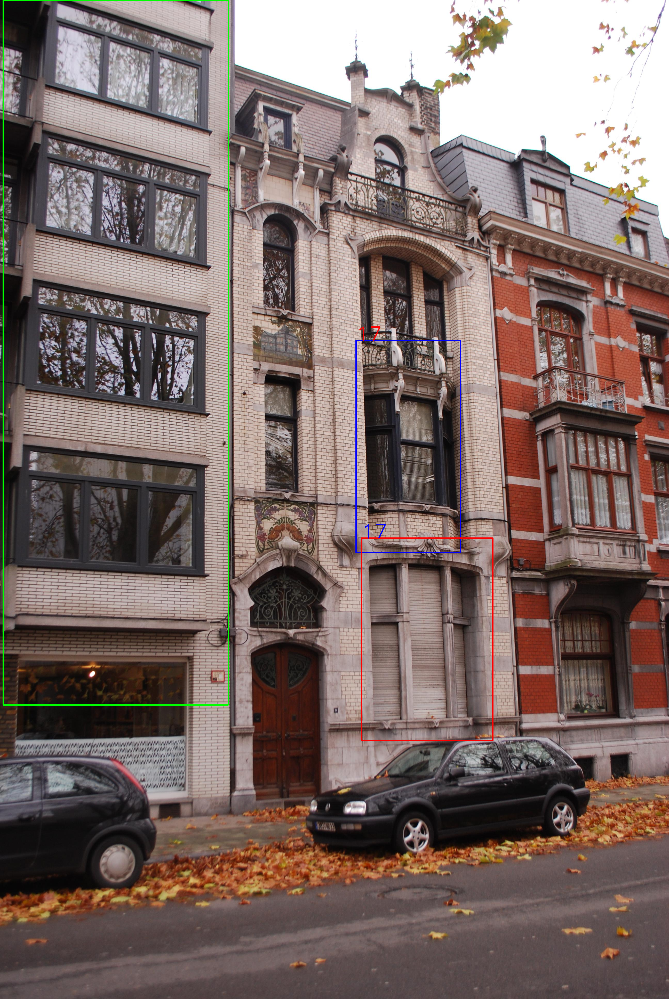

In [ ]:
val1=y_pred[0]["boxes"][1].tolist()
val2=y_pred[0]["boxes"][2].tolist()
val3=y_pred[0]["boxes"][3].tolist()
label=y_pred[0]['labels'][0].tolist()
color = (255, 0, 0) 
color1=(0,255,0) 
color2=(0,0,255) 
start_point=(int(val1[0]),int(val1[1]))
end_point= (int(val1[2]),int(val1[3]))
start_point1=(int(val2[0]),int(val2[1]))
end_point1= (int(val2[2]),int(val2[3]))
start_point2=(int(val3[0]),int(val3[1]))
end_point2= (int(val3[2]),int(val3[3]))
# Line thickness of 2 px 
thickness = 3
# Using cv2.rectangle() method 
# Draw a rectangle with blue line borders of thickness of 2 px 
img =cv2.imread('/content/drive/MyDrive/rcnn_dataset/rcnn_dataset/image-000'+img_id+'.jpg')
type(img)
text_size=2.5
cv2.rectangle(img, start_point , end_point , color, thickness) 
cv2.rectangle(img,start_point1 , end_point1, color1, thickness)
cv2.rectangle(img,  start_point2 , end_point2 , color2, thickness)
cv2.putText(img,str(label), start_point, cv2.FONT_HERSHEY_SIMPLEX, text_size, (0,0,255),thickness=3)
cv2.putText(img,str(label), start_point1, cv2.FONT_HERSHEY_SIMPLEX, text_size, (0,255,0),thickness=3)
cv2.putText(img,str(label), start_point2, cv2.FONT_HERSHEY_SIMPLEX, text_size, (255,0,0),thickness=3)
cv2_imshow(img)
cv2.waitKey(0)
cv2.destroyAllWindows()


Loading the images from test dataset[10], unsqueesing it to fit the input format printing the predicted values and actual targets.

#Output of 2nd random sample from test dataset

In [ ]:
images, targets = dataset_test[10]
images= images.unsqueeze(0)
images= images.to(device)
type(images)
with torch.no_grad():
  y_pred=model(images)
print("y_pred",y_pred)
print("targets",targets)

y_pred [{'boxes': tensor([[1519.2814,  795.6280, 2479.6067, 1688.5392],
        [1456.9447,  668.0540, 2549.6877, 1709.3531],
        [   0.0000,  857.8149,  822.8888, 1607.1458],
        [   0.0000,  936.2037,  846.7458, 1595.5742],
        [1458.6393,  741.9672, 2184.6816, 1744.5867],
        [   5.6485, 1001.9911,  734.1475, 1602.9148],
        [ 921.7781,  637.6038, 2554.7512, 1688.8313],
        [  18.2161,  988.4035,  775.6650, 1610.9656]]), 'labels': tensor([16,  1, 13, 11,  6,  2, 16, 12]), 'scores': tensor([0.9195, 0.2314, 0.1658, 0.1043, 0.0927, 0.0913, 0.0634, 0.0616])}]
targets {'boxes': tensor([[1458.4054,  814.2162, 2515.1621, 1670.9730]]), 'labels': tensor([16]), 'id': tensor([6926]), 'image_id': tensor([2604]), 'iscrowd': tensor([0])}


2604


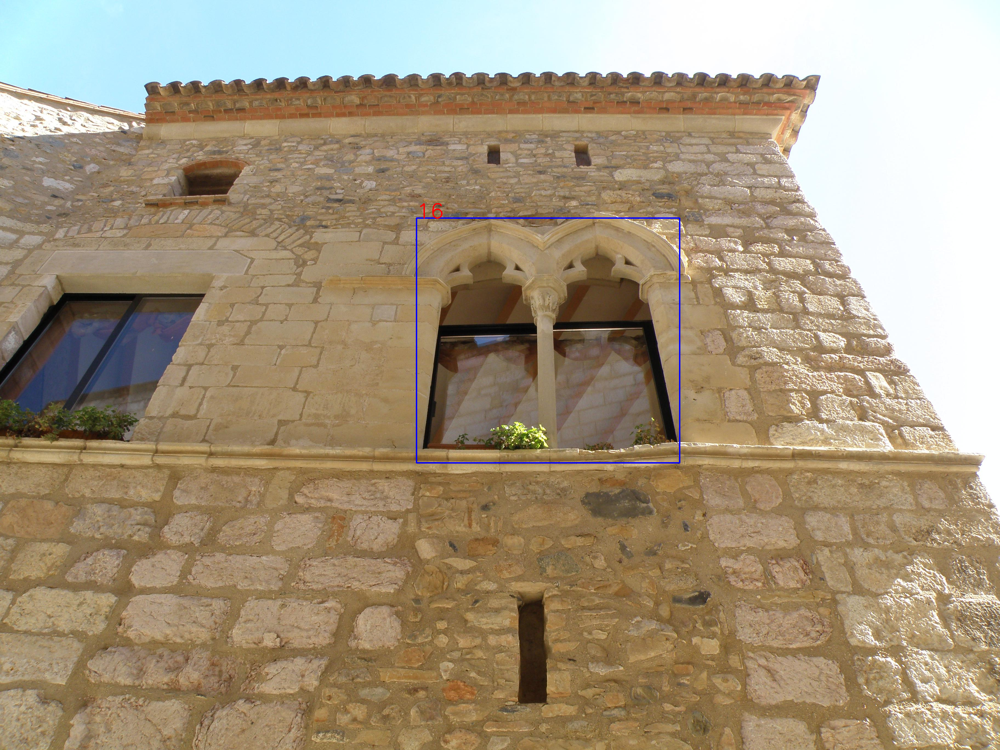

In [ ]:
img_id= targets["image_id"][0].tolist()
print(img_id)
img_id=str(img_id)
type(img_id)
val1=y_pred[0]["boxes"][0].tolist()
label=y_pred[0]['labels'][0].tolist()
color = (255, 0, 0) 
start_point=(int(val1[0]),int(val1[1]))
end_point= (int(val1[2]),int(val1[3]))
img =cv2.imread('/content/drive/MyDrive/rcnn_dataset/rcnn_dataset/image-00'+img_id+'.jpg')
cv2.rectangle(img, start_point , end_point , color, thickness) 
cv2.putText(img,str(label), start_point, cv2.FONT_HERSHEY_SIMPLEX, text_size, (0,0,255),thickness=3)
cv2_imshow(img)
cv2.waitKey(0)
cv2.destroyAllWindows()

#Output of 3rd random sample from training dataset

In [ ]:
images, targets = dataset[25]
images= images.unsqueeze(0)
images= images.to(device)
type(images)
with torch.no_grad():
  y_pred=model(images)
print("y_pred",y_pred)
print("targets",targets)

y_pred [{'boxes': tensor([[1058.4971,  984.5784, 1325.3738, 1323.4636],
        [ 227.6198, 1251.8110,  396.7024, 1546.6512],
        [ 573.5104,  383.8010,  766.8628,  690.5961],
        [ 734.7402, 1010.0565,  989.1079, 1403.3470],
        [1055.7369,  992.1592, 1316.4957, 1342.2837],
        [1919.8739,  638.1385, 3011.7209, 1117.4073],
        [1065.1375,  956.7979, 1294.6267, 1357.0676],
        [ 722.7726,  639.9074,  869.3433,  945.6810],
        [1042.3806,  931.8218, 1323.8538, 1333.4711],
        [ 746.5563, 1027.9747, 1003.4481, 1410.9554],
        [ 234.5272, 1259.6115,  408.2098, 1567.5635],
        [ 599.1019,  424.5816,  754.4456,  679.3970]]), 'labels': tensor([11, 13, 13, 13, 18,  7, 17, 13, 13, 11, 11,  7]), 'scores': tensor([0.4195, 0.2136, 0.1878, 0.1744, 0.1693, 0.1400, 0.1194, 0.1193, 0.1013,
        0.0872, 0.0781, 0.0658])}]
targets {'boxes': tensor([[1046.1111,  982.0000, 1343.3334, 1354.2222]]), 'labels': tensor([11]), 'id': tensor([6189]), 'image_id': tensor(

3308


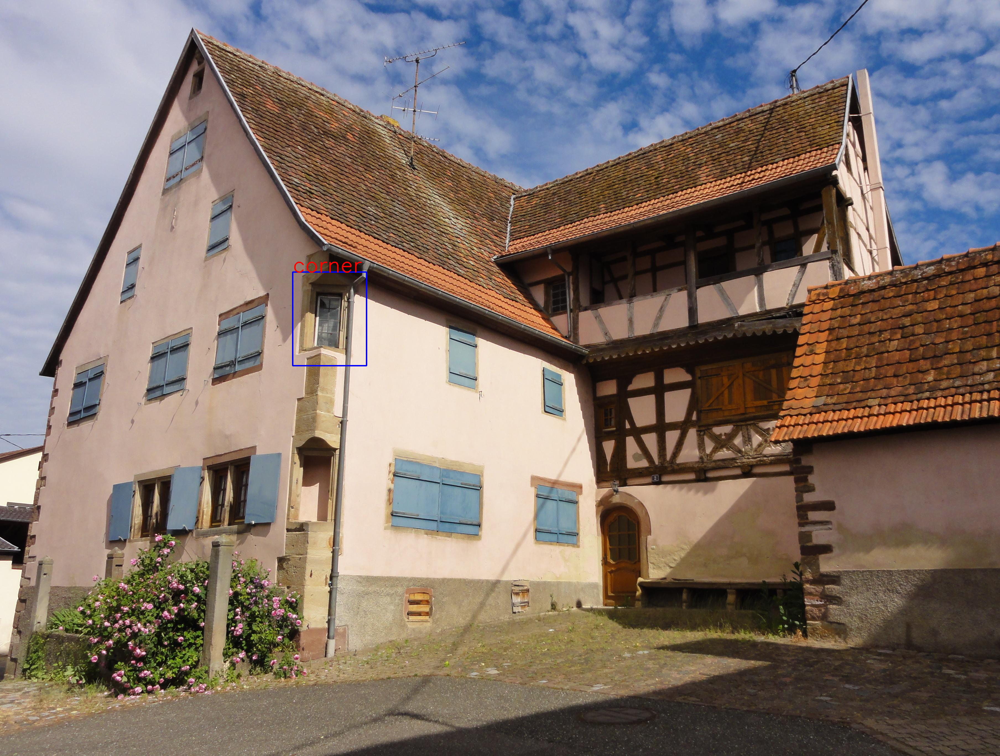

In [ ]:
img_id= targets["image_id"][0].tolist()
print(img_id)
img_id=str(img_id)
type(img_id)
val1=y_pred[0]["boxes"][0].tolist()
label=y_pred[0]['labels'][0].tolist()
label="corner"
color = (255, 0, 0) 
start_point=(int(val1[0]),int(val1[1]))
end_point= (int(val1[2]),int(val1[3]))
img =cv2.imread('/content/drive/MyDrive/rcnn_dataset/rcnn_dataset/image-00'+img_id+'.jpg')
cv2.rectangle(img, start_point , end_point , color, thickness) 
cv2.putText(img,label, start_point, cv2.FONT_HERSHEY_SIMPLEX, text_size, (0,0,255),thickness=3)
cv2_imshow(img)
cv2.waitKey(0)
cv2.destroyAllWindows()

#Output of 4th random sample from test dataset

In [ ]:
#images, targets = dataset_test[42]
images, targets = dataset_test[28]
images= images.unsqueeze(0)
images= images.to(device)
type(images)
with torch.no_grad():
  y_pred=model(images)
print("y_pred",y_pred)
print("targets",targets)

y_pred [{'boxes': tensor([[ 706.8949,  692.2975, 1040.2775, 1140.5985],
        [1027.6821,  441.5588, 1972.8870,  619.3641],
        [ 715.2502,  747.2200, 1039.1643, 1064.6294],
        [ 691.5275,  723.9789, 1072.8925, 1093.1245],
        [1238.2563,  472.6135, 1554.1475,  593.0502],
        [ 556.1258,  548.7824, 2048.1624, 1244.0284],
        [ 570.1606,  676.2714, 1951.2244, 1203.2706],
        [1113.6107,  422.5793, 1606.9410,  610.2524],
        [1164.8728,  454.0837, 1591.1519,  597.4041],
        [1538.1997,  464.9830, 1979.2498,  602.0900],
        [ 676.1765,  697.6529, 1086.4880, 1127.0052]]), 'labels': tensor([17,  7,  3, 18,  7, 17, 18, 13, 11,  7, 11]), 'scores': tensor([0.6038, 0.2692, 0.1669, 0.1618, 0.1366, 0.1029, 0.0848, 0.0762, 0.0622,
        0.0580, 0.0509])}]
targets {'boxes': tensor([[ 670.6667,  672.0000, 1074.0000, 1170.3334]]), 'labels': tensor([18]), 'id': tensor([9849]), 'image_id': tensor([2944]), 'iscrowd': tensor([0])}


**Miss prediction**(instead of Bow it predicted it as Bay window)

2944


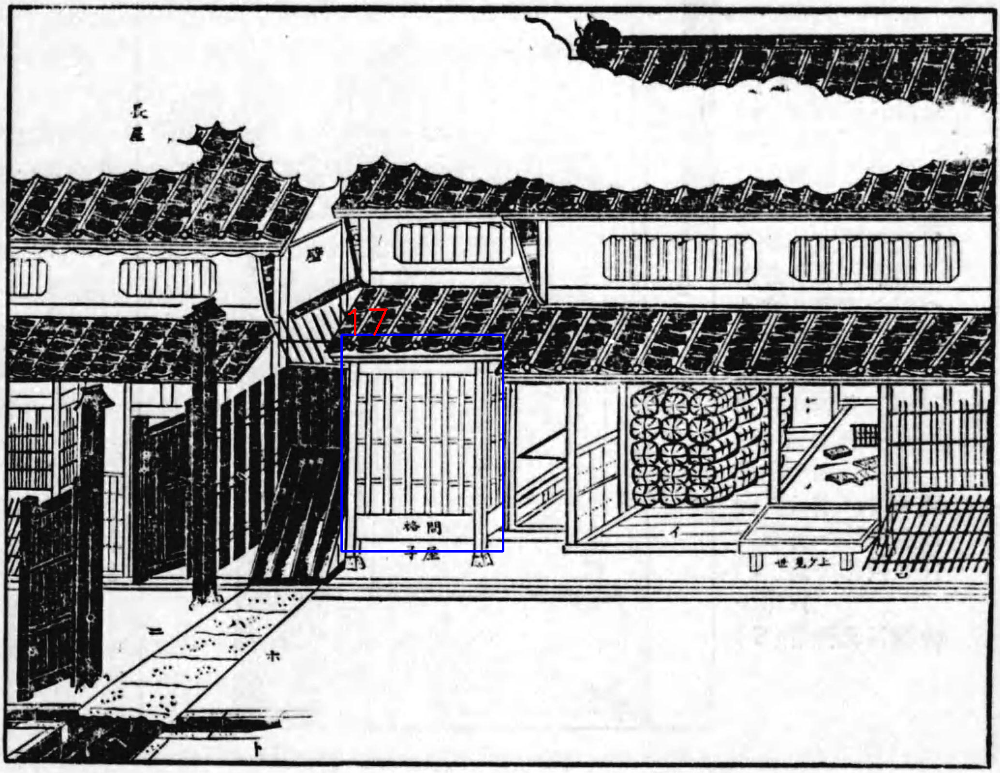

In [ ]:
img_id= targets["image_id"][0].tolist()
print(img_id)
img_id=str(img_id)
type(img_id)
val1=y_pred[0]["boxes"][0].tolist()
label=y_pred[0]['labels'][0].tolist()
color = (255, 0, 0) 
start_point=(int(val1[0]),int(val1[1]))
end_point= (int(val1[2]),int(val1[3]))
img =cv2.imread('/content/drive/MyDrive/rcnn_dataset/rcnn_dataset/image-00'+img_id+'.jpg')
cv2.rectangle(img, start_point , end_point , color, thickness) 
cv2.putText(img,str(label), start_point, cv2.FONT_HERSHEY_SIMPLEX, text_size, (0,0,255),thickness=3)
cv2_imshow(img)
cv2.waitKey(0)
cv2.destroyAllWindows()

#Conclusion

The custom-made data loader class helped us in fetching the images and annotations, also based on the requirements the parameters of the annotations are extracted and converted to tensor and used as our targets for the predictions. The fasterRCNN resnet-50 model weights are used as a starting point and upon it we trained the model with our dataset. 

The training was done in various epoch rates, like 2, 3 and 5. After the 5th epoch our classification error became 0.2312 and the bounding box regression loss = 0.1245. Finally, we used our test dataset to evaluate the model performance. Their predictions are compared against the target values and the predicted bounding boxes are plotted over the image using cv2 image processing library.


#References

1. Deep Residual Learning for Image Recognition,Kaiming He and Xiangyu  Zhang and Shaoqing Ren and Jian Sunm, "arXiv", 2015.

2. Faster R-CNN: Towards Real-Time Object Detection with Region Proposal Networks, Shaoqing Ren and Kaiming He and Ross Girshick and Jian Sun,"arXiv",2016.

#Note 
Based on the ouput predictions the number of boxes and label values are fetched from the y_pred list and depening upon the number of boxes the cv2.rectangle functions are created and plotted against the images. 

#Link for files
The below files are need to be downloaded and to placed in your local directory in order to run the cells.

https://drive.google.com/drive/folders/1Q7_E6n5Ac25TvH70X0SdCWjO4J-O-VQ2?usp=sharing


